In [2]:
'''
The code serves three primary functions:

    Calculate A-P Profile and Identify Stripes:
        Computes the anterior-posterior (A-P) intensity profile of a fruit fly embryo by averaging pixel intensities column-wise within a specified embryo binary mask.

    Compare Whole Embryo Profiles by Alignment:
        Aligns the entire A-P profiles of the target and control embryos onto a common X-axis.
        Ensures differences in overall stripe intensity patterns can be compared across embryos by normalization. 

    Compare Stripes by Regional Alignment:
        Detects stripe boundaries using peak detection and dynamically determines start and end indices to isolate the relevant regions of interest.
        Focuses on specific stripe regions by aligning peak positions from the target and control embryos.
'''

'\nThe code serves three primary functions:\n\n    Calculate A-P Profile and Identify Stripes:\n        Computes the anterior-posterior (A-P) intensity profile of a fruit fly embryo by averaging pixel intensities column-wise within a specified embryo binary mask.\n\n    Compare Whole Embryo Profiles by Alignment:\n        Aligns the entire A-P profiles of the target and control embryos onto a common X-axis.\n        Ensures differences in overall stripe intensity patterns can be compared across embryos by normalization. \n\n    Compare Stripes by Regional Alignment:\n        Detects stripe boundaries using peak detection and dynamically determines start and end indices to isolate the relevant regions of interest.\n        Focuses on specific stripe regions by aligning peak positions from the target and control embryos.\n'

In [3]:
import importlib
import os
import re
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from skimage import io, filters, measure, segmentation, exposure
from skimage import morphology
from skimage.color import rgb2gray
from scipy import signal, stats
from scipy.ndimage import gaussian_filter1d
from scipy.signal import find_peaks
import cv2
from sklearn.cluster import HDBSCAN
import pandas as pd
import math
import StripesFunctions
importlib.reload(StripesFunctions)


<module 'StripesFunctions' from '/Users/julia/GitHub/eve_BAC_analysis/StripesFunctions.py'>

In [4]:
## this function needs to stay on main or it makes a mess
# draw ROI to find stripes 
def click_event(event, x, y, flags, param):
        global points, drawing, AllPoints, i
        if event == cv2.EVENT_LBUTTONDOWN:
            drawing = True
            points.append((x,y))
            cv2.circle(img, (x,y), 3, (0, 0, 255), -1)
        elif event == cv2.EVENT_LBUTTONUP:
            drawing = False
            cv2.line(img, points[-1], (x,y), (0, 0, 255), 2)
            points.append((x,y))
        elif event == cv2.EVENT_RBUTTONDOWN: # Right click to complete polygon
            if len(points) > 2:
                cv2.polylines(img, [np.array(points)], True, (0, 0, 255), 2)
                AllPoints[i] = points
                i += 1
                points = [] # Reset points for new polygon
            else:
                points = [] # Reset points if less than 3
        elif key == 27: # Press Esc to exit
            cv2.destroyAllWindows()

In [5]:
    """
    RUN ON SELECTED FOLDER
    """
    # MAIN
    import cv2
    import numpy as np
        
#     Path = '/Volumes/ElementsOld/Confocal/to_analyze/BACAID/50/' ;
# Path = '/Volumes/ElementsOld/Confocal/to_analyze/BAC_5-5/50/' ;
#     Path = '/Volumes/ElementsOld/Confocal/to_analyze/BACAID/' ;
    Path = '/Volumes/ElementsOld/Confocal/to_analyze/Bac_11/' ;
#     Path = '/Volumes/ElementsOld/Confocal/to_analyze/BACctr/50/' ;

#     Path = '/Volumes/ElementsOld/Confocal temp/to_analyze/Dfctr/' ;
    FilesDF = [f for f in os.listdir(Path) if re.match(r"\w.*\.tif$", f)]
    print(FilesDF)
    for f in FilesDF:
        global axes
        fig, axes = plt.subplots(3, 5, figsize=(30, 15),dpi=600)
        image_path = Path+f
        # Load and preprocess image
        [img_enhanced,img_smooth] = StripesFunctions.load_and_preprocess(image_path, axes[0,0])

        # Detect embryo boundary
        embryo_mask = StripesFunctions.detect_embryo_boundary(img_smooth,axes[0,1])
        
        sigma1 = 2
        sigma2 = 6
        sigma1 = 1
        sigma2 = 2
        [dog, spotsbin] = StripesFunctions.find_spots_dog(img_enhanced, sigma1, sigma2,axes[0,2])
        Shape = np.shape(spotsbin)

        # DRAW STRIPES, HAS TO RUN FROM MAIN. DOESN'T WORK INSIDE FUNCTION
        try:
            # load image with stripes
            Stripes = np.loadtxt(image_path+'_stripesROI.csv', delimiter = ',')
#             plt.figure()
            axes[0,4].imshow(Stripes)
        except:
            points = []
            drawing = False
            AllPoints = [None]*7
            i = 0
            img = np.dstack((spotsbin, spotsbin, spotsbin))
            img = np.uint8(img)*255
            # Create a window and bind the click event
            cv2.namedWindow('image')
            cv2.setMouseCallback('image', click_event)
            while True:
                cv2.imshow('image', img)
                key = cv2.waitKey(2) & 0xFF
                if key == 27: # Press Esc to exit
                    cv2.destroyAllWindows()
                    False
                    break
            print(AllPoints)
            ROIs = np.zeros((Shape[0],Shape[1],7))*7
            import skimage as ski
            image_shape = np.shape(spotsbin)
            i=0
            for polygon in AllPoints:
            #     polygon = AllPoints[6]
                mask = ski.draw.polygon2mask(image_shape, np.flip(polygon))
                mask.astype(int)
                ROIs[:,:,i]=mask*(i+1)
                i+=1
            Stripes = np.sum(ROIs,axis=2)
            axes[0,4].imshow(Stripes)
            np.savetxt(image_path+'_stripesROI.csv',Stripes.astype(int), fmt='%i',delimiter = ',')
        
        #[arrayCentroids] = find_stripes_spots(spotsbin)
        [dfSpots] = StripesFunctions.overlay_stripes_spots(spotsbin, Stripes,axes[0,3],axes[1,0])
        dfSpots = StripesFunctions.straighten_stripes(dfSpots,axes[1,1],axes[1,2])
        ReconstructedSpots = spotsbin*0
        [straightened_image] = StripesFunctions.puppet_wrap_adjCentroids(img_enhanced,dfSpots,[axes[1,3],axes[1,4],axes[2,0]])
#         print(dfSpots)
                
        embryo_mask_straight = StripesFunctions.detect_embryo_boundary(straightened_image, axes[2,1])
        #additiona masking
        embryo_mask_straight[:,0:100] = 0
        embryo_mask_straight[:,Shape[1]-100:Shape[1]] = 0
        embryo_mask_straight[0:250,:] = 0
        embryo_mask_straight[Shape[0]-250:Shape[0],:] = 0
        img_straight_smooth = filters.gaussian(straightened_image, sigma=5)
        img_straight_smooth = img_straight_smooth/np.max(img_straight_smooth)*255
        
        # Generate A-P profile
        ap_positions, intensity_profile = StripesFunctions.generate_ap_profile(img_straight_smooth, embryo_mask_straight)
        mask = ~np.isnan(intensity_profile)
        xvals = np.array(range(0,len(intensity_profile)))
#         detrended_data_no_nan = signal.detrend(intensity_profile[mask])
        intensity_profile_detrended = np.empty_like(intensity_profile, dtype=float)
        intensity_profile_detrended[:] = np.nan
        pp3 = np.polynomial.Polynomial.fit(xvals[mask], intensity_profile[mask], deg=3)  # fit degree 1 polynomial
        intensity_profile_detrended[mask] = intensity_profile[mask]-pp3(xvals[mask])
        
        np.savetxt(image_path+"_profile.csv", intensity_profile_detrended, delimiter=",")
        

        # Detect stripes
        [stripesDict,stripesList] = StripesFunctions.detect_stripes(ap_positions, intensity_profile_detrended)
#         print(stripesList)
        np.savetxt(image_path+"_stripes.csv", stripesList, delimiter=",")

        # Analyze eve2 stripe
        #eve2_analysis = analyze_eve2_stripe(stripes)
        # Create visualization

        StripesFunctions.plot_results(img_straight_smooth*embryo_mask_straight, ap_positions, StripesFunctions.normalize_intensity(intensity_profile), StripesFunctions.normalize_intensity(intensity_profile_detrended), stripesDict, axes[2,2],axes[2,3])
        
        ReconstructedSpots = spotsbin*0
        for i in range(0,len(dfSpots)):
            try:
                SpotIntensity = img_enhanced[dfSpots.CentroidY[i],dfSpots.CentroidX[i]]
                dfSpots.loc[i,'SpotIntensity'] = SpotIntensity
                ReconstructedSpots[round(dfSpots.adjCentroidY[i]),round(dfSpots.adjCentroidX[i])] = SpotIntensity*255
            except:
                pass
        np.savetxt(image_path+"_spots.csv", dfSpots, delimiter=",",header=','.join(dfSpots.columns))
        ProfileSpots = np.nansum(ReconstructedSpots,axis=0)
        smoothed_spot_profile = gaussian_filter1d(ProfileSpots, sigma=20)
        [stripesDictSpots,stripesListSpots] = StripesFunctions.detect_stripes(ap_positions, smoothed_spot_profile)
#         plt.plot(ProfileSpots)
        StripesFunctions.plot_results(img_straight_smooth*embryo_mask_straight, ap_positions, smoothed_spot_profile, smoothed_spot_profile, stripesDict, axes[2,2],axes[2,4])
        np.savetxt(image_path+"_profile_spots.csv", ProfileSpots, delimiter=",")

        fig.savefig(image_path+"_out.pdf")
        plt.close()

    

['20250904_MAX_Bac11 TR1.czi - Bac11 TR1.czi #1.tif', '20250904_MAX_Bac11 TR2.czi - Bac11 TR2.czi #1.tif', '20250904_MAX_Bac11 TR3.czi - Bac11 TR3.czi #1.tif', '20250904_MAX_Bac11 TR4.czi - Bac11 TR4.czi #1.tif', '20250904_MAX_Bac11 TR5.czi - Bac11 TR5.czi #1.tif', '20250904_MAX_Bac11 TR6.czi - Bac11 TR6.czi #1.tif', '20250904_MAX_Bac11 TR68.czi - Bac11 TR68.czi #1.tif', '20250904_MAX_Bac11 TR7.czi - Bac11 TR7.czi #1.tif', '20250904_MAX_Bac11 TR8.czi - Bac11 TR8.czi #1.tif', '20250904_MAX_Bac11 TR9.czi - Bac11 TR9.czi #1.tif', '20250904_MAX_Bac11 TR10.czi - Bac11 TR10.czi #1.tif', '20250904_MAX_Bac11 TR12.czi - Bac11 TR12.czi #1.tif', '20250904_MAX_Bac11 TR14.czi - Bac11 TR14.czi #1.tif', '20250904_MAX_Bac11 TR16.czi - Bac11 TR16.czi #1.tif', '20250904_MAX_Bac11 TR20.czi - Bac11 TR20.czi #1.tif', '20250904_MAX_Bac11 TR21.czi - Bac11 TR21.czi #1.tif', '20250904_MAX_Bac11 TR22.czi - Bac11 TR22.czi #1.tif', '20250904_MAX_Bac11 TR25.czi - Bac11 TR25.czi #1.tif', '20250904_MAX_Bac11 TR30.cz

In [6]:
## AUTOMATIC TIMEPOINT ASSIGNMENT
# load reference control
Path = '/Volumes/ElementsOld/Confocal/to_analyze/'
Ctr = 'BACctr/'
Timepoints = ['20','30','40','50'];
# Timepoints = ['30'];
StripeStatsRef = pd.DataFrame()
StripeStatsRef['TimePoint'] = np.nan
StripeStatsRef['FileName'] = np.nan
StripeStatsRef['StripeNumber'] = np.nan
StripeStatsRef['StripeWidth'] = np.nan
StripeStatsRef['AvInt'] = np.nan

for Timepoint in Timepoints:
    FullPath = Path+Ctr+Timepoint+'/'
    Split = FullPath.split('/')
    FilesDF = [f for f in os.listdir(FullPath) if re.match(r"\w.*profile\.csv$", f)]
#     print(FilesDF)
    InterpolatedProfilesCtr = np.zeros((4096,len(FilesDF)))
    InterpolatedSpotsProfilesCtr = np.zeros((4096,len(FilesDF)))
    for file in FilesDF:
        Profile = np.loadtxt(FullPath+file, delimiter = ',')
        StripesFile = file.replace("profile.csv", "stripes.csv")
        SpotsProfileFile = file.replace("profile.csv", "profile_spots.csv")
        SpotsFile = file.replace("profile.csv", "spots.csv")
        StripePos = np.loadtxt(FullPath+StripesFile, delimiter = ',')
        SpotsProfile = np.loadtxt(FullPath+SpotsProfileFile, delimiter = ',')
        Spots = pd.read_csv(FullPath+SpotsFile)
        for Stripe in [1,2,3,4,5,6,7]:
            SubSpots = Spots[Spots.Labels==Stripe]
#             Width = np.max(SubSpots.adjCentroidX) - np.min(SubSpots.adjCentroidX)
            Width = 2*np.std(SubSpots.adjCentroidX)
            AvInt = np.nanmean(SubSpots.SpotIntensity)
            NewLine = len(StripeStatsRef)
            StripeStatsRef.loc[NewLine,'TimePoint'] = Timepoint
            StripeStatsRef.loc[NewLine,'FileName'] = file
            StripeStatsRef.loc[NewLine,'StripeNumber'] = Stripe
            StripeStatsRef.loc[NewLine,'StripeWidth'] = Width
            StripeStatsRef.loc[NewLine,'AvInt'] = AvInt
            
AverageWidths = StripeStatsRef.groupby(['TimePoint','StripeNumber'])['StripeWidth'].mean()
        


/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_97594/3139210271.py:35: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '20' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  StripeStatsRef.loc[NewLine,'TimePoint'] = Timepoint
/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_97594/3139210271.py:36: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '20241227_BACctr_MAX_pos1.czi - pos1.czi #1.tif_profile.csv' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  StripeStatsRef.loc[NewLine,'FileName'] = file


In [7]:
    ## AUTOMATIC TIMEPOINT ASSIGNMENT
    # experiment to classify
    Path = '/Volumes/ElementsOld/Confocal/to_analyze/'
    Exp = 'Bac_11/'
    Timepoints = ['20','30','40','50'];
    # Timepoints = ['30'];
    StripeStats = pd.DataFrame()
    StripeStats['TimePoint'] = np.nan
    StripeStats['FileName'] = np.nan
    StripeStats['StripeNumber'] = np.nan
    StripeStats['StripeWidth'] = np.nan
    StripeStats['AvInt'] = np.nan
    
    FullPath = Path+Exp+'/'
    Split = FullPath.split('/')
    FilesDF = [f for f in os.listdir(FullPath) if re.match(r"\w.*profile\.csv$", f)]
    print(FilesDF)
    InterpolatedProfilesCtr = np.zeros((4096,len(FilesDF)))
    InterpolatedSpotsProfilesCtr = np.zeros((4096,len(FilesDF)))
    for file in FilesDF:
        StripeWidths = [None]*7
        Profile = np.loadtxt(FullPath+file, delimiter = ',')
        StripesFile = file.replace("profile.csv", "stripes.csv")
        SpotsProfileFile = file.replace("profile.csv", "profile_spots.csv")
        SpotsFile = file.replace("profile.csv", "spots.csv")
        OutFile = file.replace("profile.csv", "out.pdf")
        TiffFile = file.replace("_profile.csv", "")
        SpotsROIFile = file.replace("profile.csv", "stripesROI.csv")
        
        StripePos = np.loadtxt(FullPath+StripesFile, delimiter = ',')
        SpotsProfile = np.loadtxt(FullPath+SpotsProfileFile, delimiter = ',')
        Spots = pd.read_csv(FullPath+SpotsFile)
        for Stripe in [1,2,3,4,5,6,7]:
            SubSpots = Spots[Spots.Labels==Stripe]
#             Width = np.max(SubSpots.adjCentroidX) - np.min(SubSpots.adjCentroidX)
            Width = 2*np.std(SubSpots.adjCentroidX)
            StripeWidths[Stripe-1] = Width
            AvInt = np.nanmean(SubSpots.SpotIntensity)
            NewLine = len(StripeStats)
#             StripeStats.loc[NewLine,'TimePoint'] = Timepoint
            StripeStats.loc[NewLine,'FileName'] = file
            StripeStats.loc[NewLine,'StripeNumber'] = Stripe
            StripeStats.loc[NewLine,'StripeWidth'] = Width
            StripeStats.loc[NewLine,'AvInt'] = AvInt
        Euc = [None]*len(Timepoints)
        i=0
        for TimePoint in Timepoints:
            Squared = np.square(StripeWidths-AverageWidths[TimePoint])
            Euc[i] = np.sqrt(Squared[1]+Squared[3]+Squared[4]+Squared[5]+Squared[6]+Squared[7])
            i+=1
        print(Euc)
        BestFitIndex = np.argmin(Euc)
        FitTimepoint = Timepoints[BestFitIndex]
        print(FitTimepoint)
        StripeStats.loc[NewLine-7:NewLine,'TimePoint'] = FitTimepoint
        try:
            os.mkdir(FullPath+FitTimepoint+'/')
        except:
            pass
        NewPath = FullPath+FitTimepoint+'/'
        os.rename(FullPath+file, NewPath+file)
        os.rename(FullPath+StripesFile, NewPath+StripesFile)
        os.rename(FullPath+SpotsProfileFile, NewPath+SpotsProfileFile)
        os.rename(FullPath+SpotsFile, NewPath+SpotsFile)
        os.rename(FullPath+OutFile, NewPath+OutFile)
        os.rename(FullPath+TiffFile, NewPath+TiffFile)
        os.rename(FullPath+SpotsROIFile, NewPath+SpotsROIFile)


    

['20250904_MAX_Bac11 TR1.czi - Bac11 TR1.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR68.czi - Bac11 TR68.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR2.czi - Bac11 TR2.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR3.czi - Bac11 TR3.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR4.czi - Bac11 TR4.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR5.czi - Bac11 TR5.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR6.czi - Bac11 TR6.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR7.czi - Bac11 TR7.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR8.czi - Bac11 TR8.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR9.czi - Bac11 TR9.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR10.czi - Bac11 TR10.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR12.czi - Bac11 TR12.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR14.czi - Bac11 TR14.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR16.czi - Bac11 TR16.czi #1.tif_profile.csv', '20250904_MAX_Bac11 TR20.czi - Bac11 TR20.czi #1.tif_profile.csv', '20250904_MA

/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_97594/816665390.py:41: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '20250904_MAX_Bac11 TR1.czi - Bac11 TR1.czi #1.tif_profile.csv' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  StripeStats.loc[NewLine,'FileName'] = file
/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_97594/816665390.py:55: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '40' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  StripeStats.loc[NewLine-7:NewLine,'TimePoint'] = FitTimepoint


[90.64662848375558, 33.244268107675836, 48.829011411192816, 113.99137421451401]
30
[70.08960148110944, 48.86463087244737, 58.14889658184446, 131.09223238835403]
30
[117.41888507519523, 61.57249592786782, 62.35272954598538, 87.33762180761381]
30
[117.25545610810359, 60.465354420893675, 45.58694751811993, 86.65560237205747]
40
[170.30955877018098, 122.22152857519983, 68.45901479178256, 25.772107301677288]
50
[69.14995970439509, 25.1002156648928, 85.75889595098006, 153.11538350624002]
30
[85.55546483336744, 37.03694152018063, 51.827985563832584, 108.44316889024329]
30
[36.79827041053734, 42.75710228828843, 100.25335335529134, 176.7909937491899]
20
[229.94928799974713, 177.77720197682194, 129.1550122951119, 47.74737488776397]
50
[82.20093507902196, 32.00463431175873, 82.49621444922799, 138.51703648889355]
30
[222.35293434800172, 169.8425703442941, 123.48376175647644, 50.248181205878815]
50
[97.78981058921211, 40.12338331159293, 49.459311433310226, 113.8626693877157]
30
[153.0547013791041, 

2025-09-05 17:30:41,456 - 97594 - matplotlib.category - INFO: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2025-09-05 17:30:41,461 - 97594 - matplotlib.category - INFO: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2025-09-05 17:30:42,372 - 97594 - matplotlib.category - INFO: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2025-09-05 17:30:42,377 - 97594 - matplotlib.category - INFO: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before pl

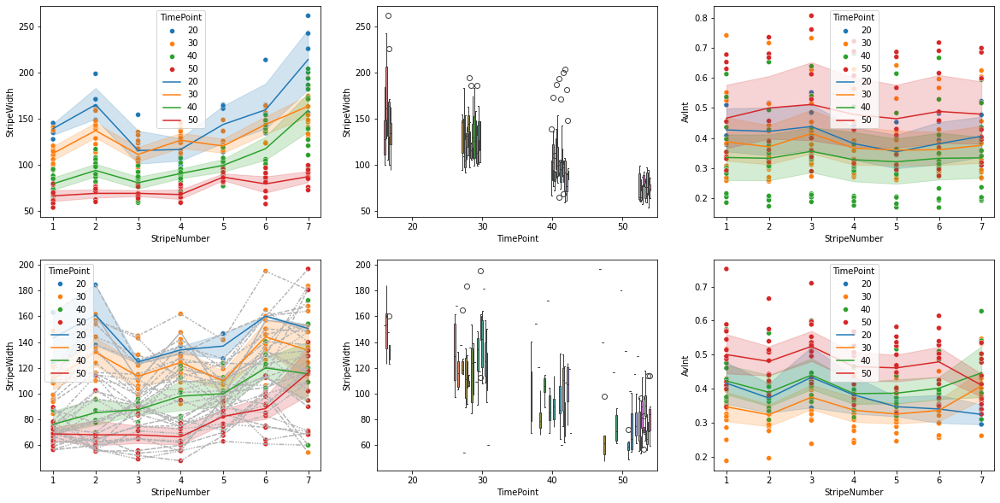

In [8]:
#StripeStats.plot(x = 'StripeNumber',y = 'StripeWidth',kind='scatter', c='TimePoint',colormap = 'viridis')
fig, ax = plt.subplots(2, 3, figsize=(20, 10))
ax = ax.ravel()
StripeStatsRef['StripeNumber'] = StripeStatsRef['StripeNumber'].astype('category')
sns.scatterplot(ax = ax[0],data=StripeStatsRef, x='StripeNumber', y='StripeWidth', hue='TimePoint')
# sns.lineplot(ax = ax[0],data=StripeStats, x='StripeNumber', y='StripeWidth', style='FileName', estimator=None,c = [0.7,0.7,0.7], legend = None)
sns.lineplot(ax = ax[0],data=StripeStatsRef, x='StripeNumber', y='StripeWidth', hue='TimePoint')
sns.boxplot(ax = ax[1],data=StripeStatsRef, x='TimePoint', y='StripeWidth', hue='FileName',legend = None)

sns.scatterplot(ax = ax[2],data=StripeStatsRef, x='StripeNumber', y='AvInt', hue='TimePoint')
sns.lineplot(ax = ax[2],data=StripeStatsRef, x='StripeNumber', y='AvInt', hue='TimePoint')

StripeStats = StripeStats.sort_values(['TimePoint','FileName','StripeNumber'])
StripeStats['StripeNumber'] = StripeStats['StripeNumber'].astype('category')
sns.scatterplot(ax = ax[3],data=StripeStats, x='StripeNumber', y='StripeWidth', hue='TimePoint')
sns.lineplot(ax = ax[3],data=StripeStats, x='StripeNumber', y='StripeWidth', style='FileName', estimator=None,c = [0.7,0.7,0.7], legend = None)
sns.lineplot(ax = ax[3],data=StripeStats, x='StripeNumber', y='StripeWidth', hue='TimePoint')
sns.boxplot(ax = ax[4],data=StripeStats, x='TimePoint', y='StripeWidth', hue='FileName',legend = None)

sns.scatterplot(ax = ax[5],data=StripeStats, x='StripeNumber', y='AvInt', hue='TimePoint')
sns.lineplot(ax = ax[5],data=StripeStats, x='StripeNumber', y='AvInt', hue='TimePoint')

fig.savefig(FullPath+"timepointclassification.pdf")    


['20241227_BACctr_MAX_pos1.czi - pos1.czi #1.tif_profile.csv', '20241227_BACctr_MAX_pos9.czi - pos9.czi #1.tif_profile.csv', '20250201_BACctr_MAX_pos4.czi - pos4.czi #1.tif_profile.csv', '20250201_BACctr_MAX_pos8.czi - pos8.czi #1.tif_profile.csv', '20250722_MAX_BAC cntrl TR44.czi - BAC cntrl TR44.czi #1.tif_profile.csv']


/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:39: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'BACctr/' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  DataFrame.loc[NewLine,'Sample'] = Ctr
/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:40: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '20' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  DataFrame.loc[NewLine,'TimePoint'] = Timepoint


['20250624_MAX_BAC 5-3 tr3.czi - BAC 5-3 tr3.czi #1.tif_profile.csv']


/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:266: RuntimeWarning: Mean of empty slice
  Mean = np.nanmean(InterpolatedProfiles,axis=1)


['20250703_BAC_5-4_MAX_BAC 5-4 TR23.czi - BAC 5-4 TR23.czi #1.tif_profile.csv', '20250703_BAC_5-4_MAX_BAC 5-4 TR25.czi - BAC 5-4 TR25.czi #1.tif_profile.csv', '20250703_BAC_5-4_MAX_BAC 5-4 TR27.czi - BAC 5-4 TR27.czi #1.tif_profile.csv', '20250703_BAC_5-4_MAX_BAC 5-4 TR9.czi - BAC 5-4 TR9.czi #1.tif_profile.csv', '20250703_BAC_5-4_MAX_BAC 5-4 TR16.czi - BAC 5-4 TR16.czi #1.tif_profile.csv']
['20250508_BAC_5-5_MAX_5-5-Split Scenes-05.czi - 5-5-Split Scenes-05.czi #1.tif_profile.csv', '20250513_BAC_5-5_MAX_5-5 TR15.czi - 5-5 TR15.czi #1.tif_profile.csv', '20250605_BAC_5-5_MAX_BAC 5-5 TR10.czi - BAC 5-5 TR10.czi #1.tif_profile.csv', '20250605_BAC_5-5_MAX_BAC 5-5 TR18.czi - BAC 5-5 TR18.czi #1.tif_profile.csv', '20250605_BAC_5-5_MAX_BAC 5-5 TR40.czi - BAC 5-5 TR40.czi #1.tif_profile.csv']
['20250529_BAC_6-2_MAX_BAC 6-2 TR27.czi - BAC 6-2 TR27.czi #1.tif_profile.csv', '20250703_BAC_6-2_MAX_BAC 6-2 TR4.czi - BAC 6-2 TR4.czi #1.tif_profile.csv', '20250703_BAC_6-2_MAX_BAC 6-2 TR3.czi - BAC 6-2

/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:251: RuntimeWarning: Mean of empty slice
  DataFrame.loc[NewLine,'avPeakSt2'] = np.nanmean(Intensity2)
/Users/julia/Library/Python/3.9/lib/python/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:253: RuntimeWarning: Mean of empty slice
  DataFrame.loc[NewLine,'avPeakSpotsSt2'] = np.nanmean(IntensitySpots2)
/Users/julia/Library/Python/3.9/lib/python/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:255: RuntimeWarning: Mean of empty slice
  DataFrame.loc[NewLine,'FCPeakSpotsSt2'] = np.nanmean(IntensitySpots2)/PeakSpotsSt2Ctr
/var/folders/0

['20250529_BAC_8-0_MAX_BAC 8-0 TR42.czi - BAC 8-0 TR42.czi #1.tif_profile.csv']


/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:266: RuntimeWarning: Mean of empty slice
  Mean = np.nanmean(InterpolatedProfiles,axis=1)


['20250508_BAC_8-2_MAX_8-2 TR30.czi - 8-2 TR30.czi #1.tif_profile.csv', '20250513_BAC_8-2_MAX_8-2 TR22.czi - 8-2 TR22.czi #1.tif_profile.csv', '20250508_BAC_8-2_MAX_8-2 TR20.czi - 8-2 TR20.czi #1.tif_profile.csv']


/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:290: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(5, 5, figsize=(25, 20))


['20250508_BAC_8-3_MAX_8-3 TR47.czi - 8-3 TR47.czi #1.tif_profile.csv', '20250508_BAC_8-3_MAX_8-3 TR48.czi - 8-3 TR48.czi #1.tif_profile.csv', '20250508_BAC_8-3_MAX_8-3 TR54.czi - 8-3 TR54.czi #1.tif_profile.csv', '20250508_BAC_8-3_MAX_8-3 TR43.czi - 8-3 TR43.czi #1.tif_profile.csv']
[]


/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:251: RuntimeWarning: Mean of empty slice
  DataFrame.loc[NewLine,'avPeakSt2'] = np.nanmean(Intensity2)
/Users/julia/Library/Python/3.9/lib/python/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:253: RuntimeWarning: Mean of empty slice
  DataFrame.loc[NewLine,'avPeakSpotsSt2'] = np.nanmean(IntensitySpots2)
/Users/julia/Library/Python/3.9/lib/python/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:255: RuntimeWarning: Mean of empty slice
  DataFrame.loc[NewLine,'FCPeakSpotsSt2'] = np.nanmean(IntensitySpots2)/PeakSpotsSt2Ctr
/var/folders/0

[]


/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:251: RuntimeWarning: Mean of empty slice
  DataFrame.loc[NewLine,'avPeakSt2'] = np.nanmean(Intensity2)
/Users/julia/Library/Python/3.9/lib/python/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:253: RuntimeWarning: Mean of empty slice
  DataFrame.loc[NewLine,'avPeakSpotsSt2'] = np.nanmean(IntensitySpots2)
/Users/julia/Library/Python/3.9/lib/python/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:255: RuntimeWarning: Mean of empty slice
  DataFrame.loc[NewLine,'FCPeakSpotsSt2'] = np.nanmean(IntensitySpots2)/PeakSpotsSt2Ctr
/var/folders/0

['20250805_MAX_Bac4 TR6.czi - Bac4 TR6.czi #1.tif_profile.csv', '20250805_MAX_Bac4 TR29.czi - Bac4 TR29.czi #1.tif_profile.csv', '20250805_MAX_Bac4 TR30.czi - Bac4 TR30.czi #1.tif_profile.csv', '20250805_MAX_Bac4 TR32.czi - Bac4 TR32.czi #1.tif_profile.csv', '20250805_MAX_Bac4 TR42.czi - Bac4 TR42.czi #1.tif_profile.csv', '20250805_MAX_Bac4 TR3.czi - Bac4 TR3.czi #1.tif_profile.csv', '20250805_MAX_Bac4 TR27.czi - Bac4 TR27.czi #1.tif_profile.csv']
['20250826_MAX_Bac5 TR4.czi - Bac5 TR4.czi #1.tif_profile.csv', '20250829_MAX_Bac5 TR6.czi - Bac5 TR6.czi #1.tif_profile.csv', '20250829_MAX_Bac5 TR31.czi - Bac5 TR31.czi #1.tif_profile.csv', '20250829_MAX_Bac5 TR37.czi - Bac5 TR37.czi #1.tif_profile.csv']
['20250813_MAX_Bac6 TR5.czi - Bac6 TR5.czi #1.tif_profile.csv', '20250813_MAX_Bac6 TR7.czi - Bac6 TR7.czi #1.tif_profile.csv', '20250813_MAX_Bac6 TR13.czi - Bac6 TR13.czi #1.tif_profile.csv', '20250813_MAX_Bac6 TR14.czi - Bac6 TR14.czi #1.tif_profile.csv', '20250813_MAX_Bac6 TR18.czi - Bac6

/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/2207357418.py:266: RuntimeWarning: Mean of empty slice
  Mean = np.nanmean(InterpolatedProfiles,axis=1)


['20241227_BACctr_MAX_pos4.czi - pos4.czi #1.tif_profile.csv', '20241227_BACctr_MAX_pos2.czi - pos2.czi #1.tif_profile.csv', '20250201_BACctr_MAX_pos5.czi - pos5.czi #1.tif_profile.csv', '20250201_BACctr_MAX_pos6.czi - pos6.czi #1.tif_profile.csv', '20250722_MAX_BAC cntrl TR28.czi - BAC cntrl TR28.czi #1.tif_profile.csv', '20250722_MAX_BAC cntrl TR34.czi - BAC cntrl TR34.czi #1.tif_profile.csv', '20250722_MAX_BAC cntrl TR36.czi - BAC cntrl TR36.czi #1.tif_profile.csv', '20250722_MAX_BAC cntrl TR39.czi - BAC cntrl TR39.czi #1.tif_profile.csv', '20250722_MAX_BAC cntrl TR40.czi - BAC cntrl TR40.czi #1.tif_profile.csv', '20250722_MAX_BAC cntrl TR50.czi - BAC cntrl TR50.czi #1.tif_profile.csv', '20250722_MAX_BAC cntrl TR52.czi - BAC cntrl TR52.czi #1.tif_profile.csv', '20250722_MAX_BAC cntrl TR55.czi - BAC cntrl TR55.czi #1.tif_profile.csv', '20250722_MAX_BAC cntrl TR58.czi - BAC cntrl TR58.czi #1.tif_profile.csv']
['20250624_MAX_BAC 5-3 tr1.czi - BAC 5-3 tr1.czi #1.tif_profile.csv', '20250

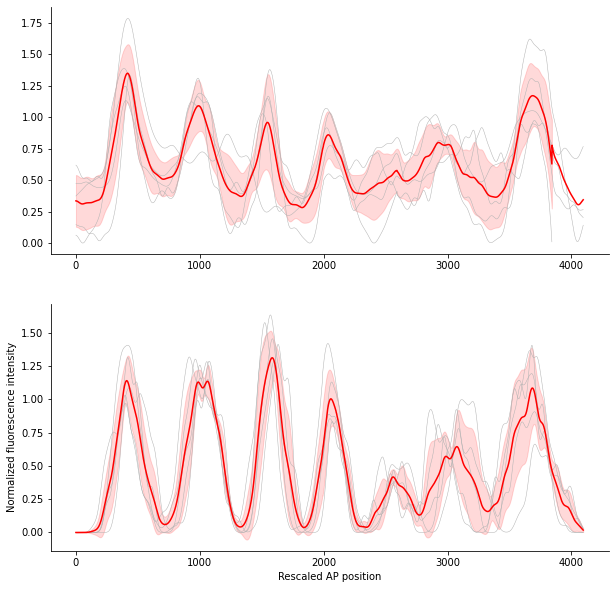

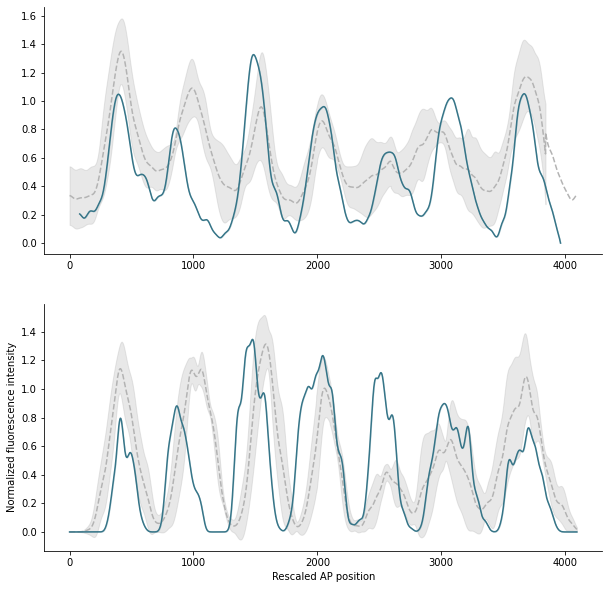

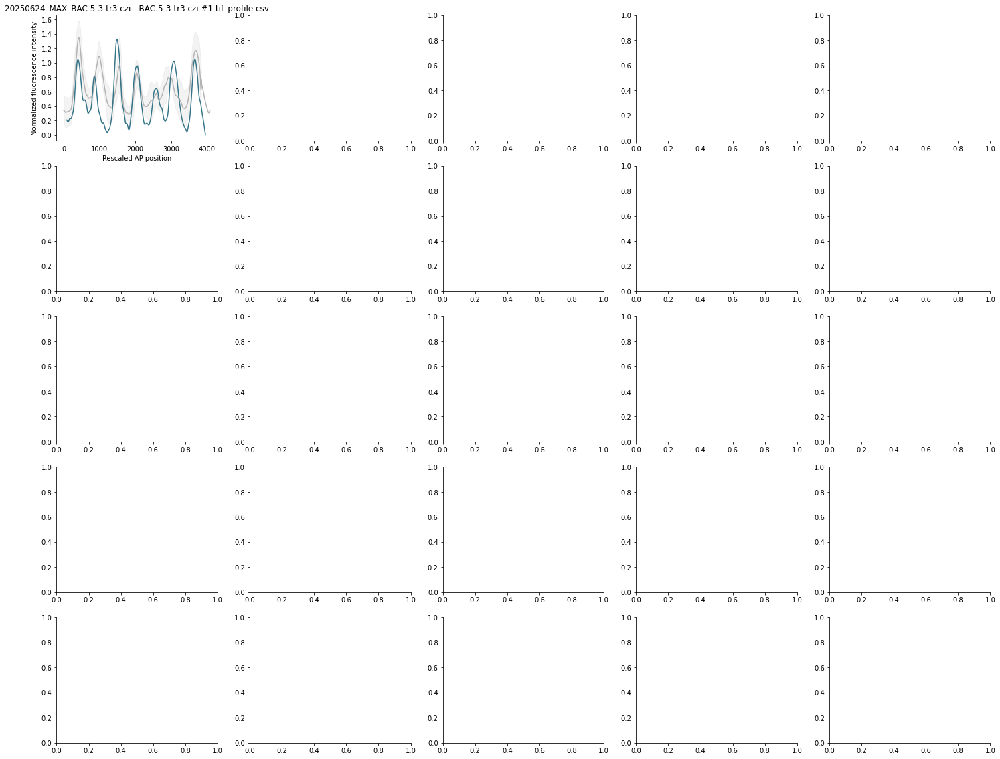

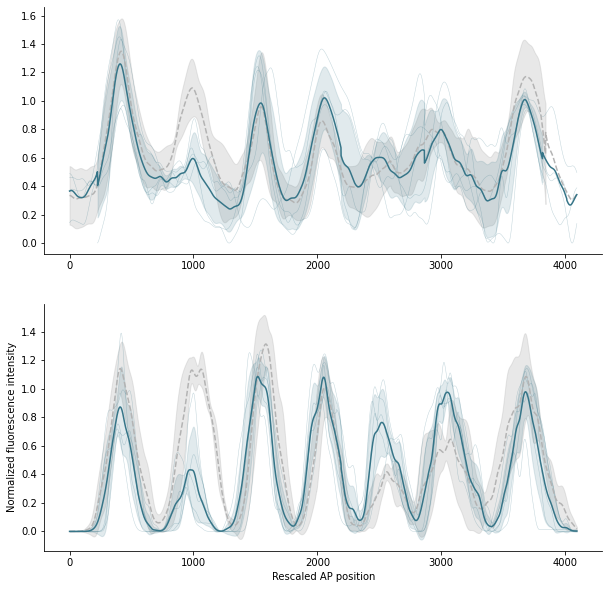

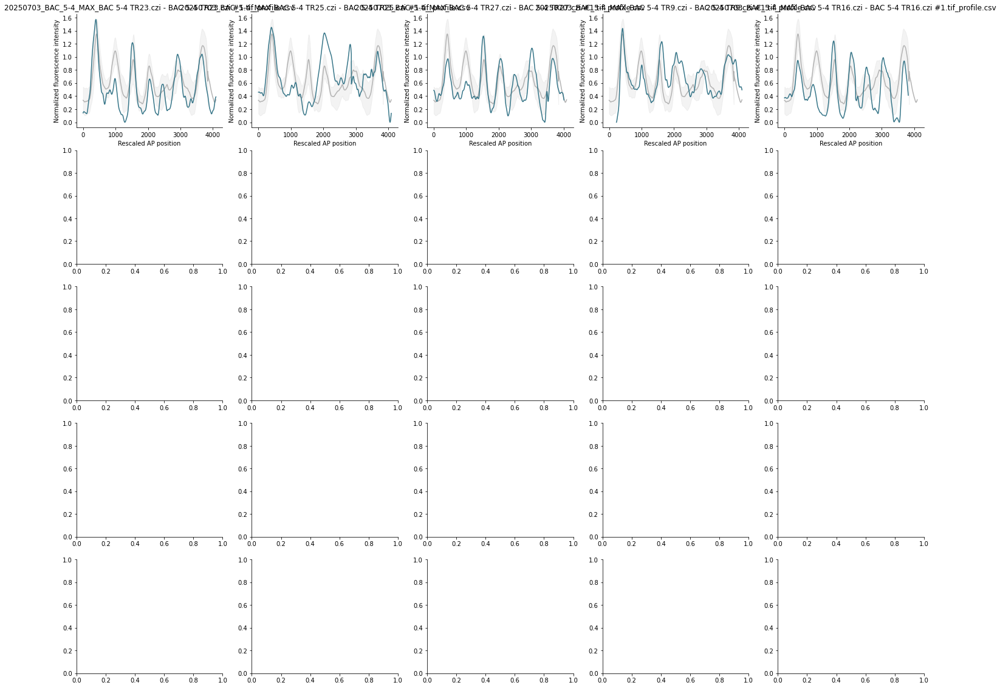

...

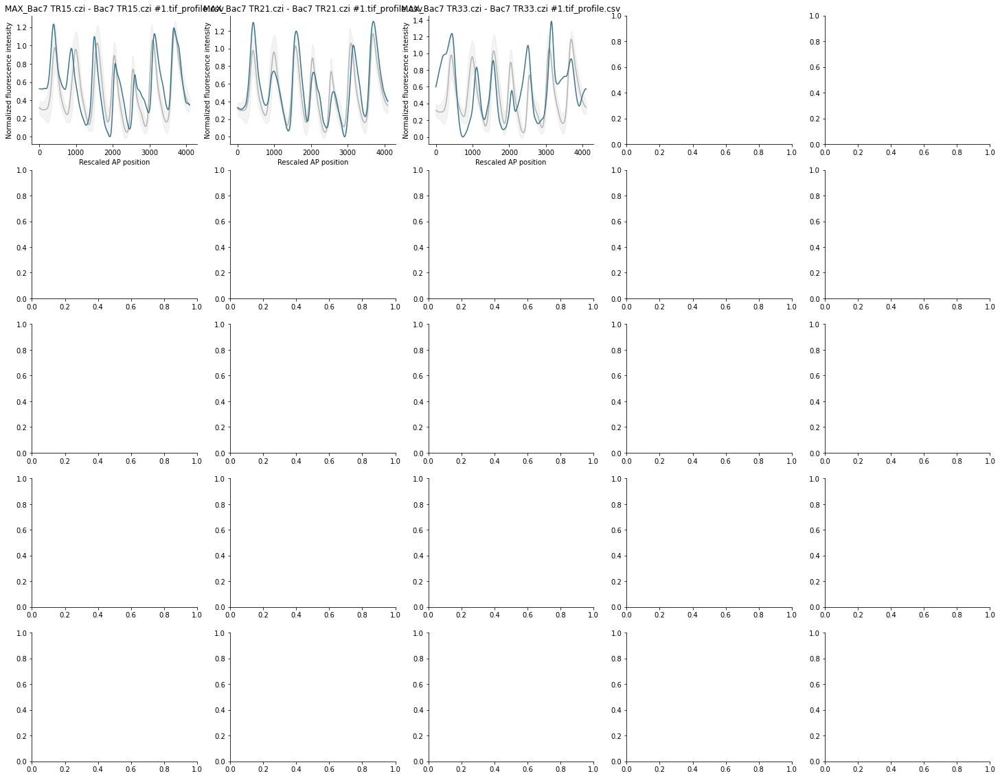

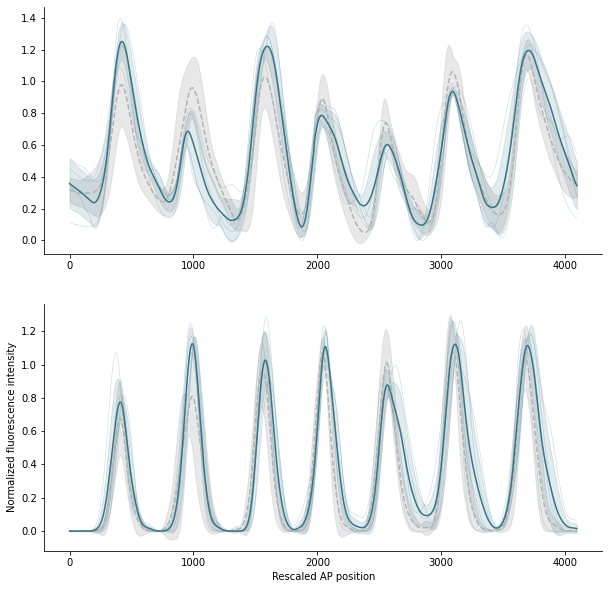

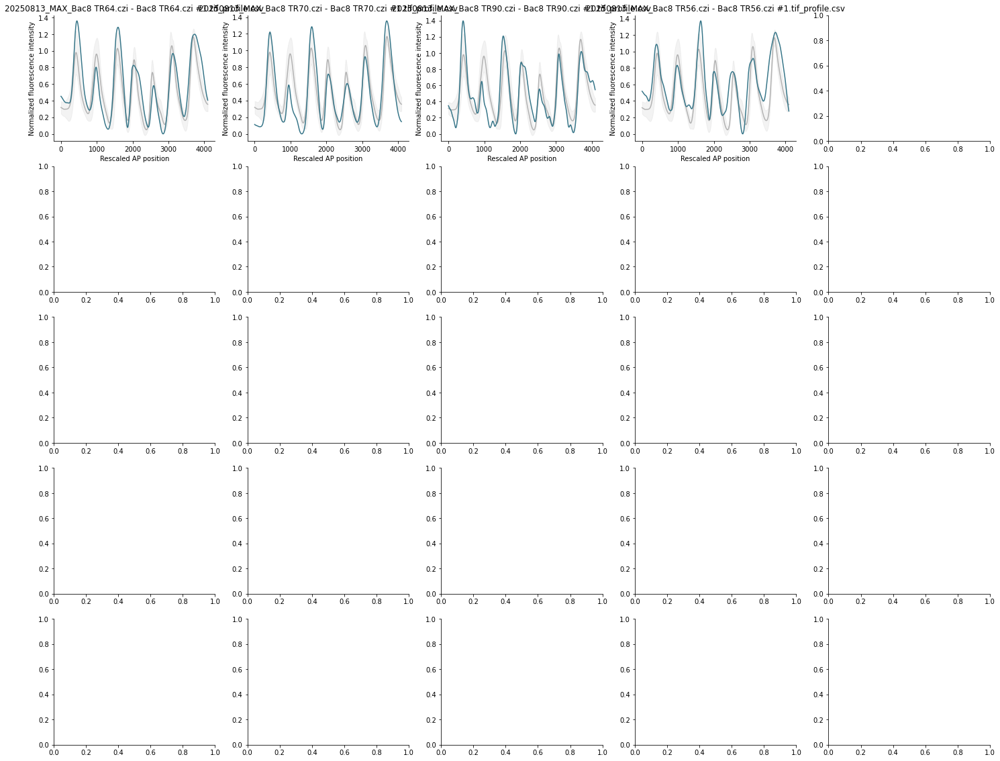

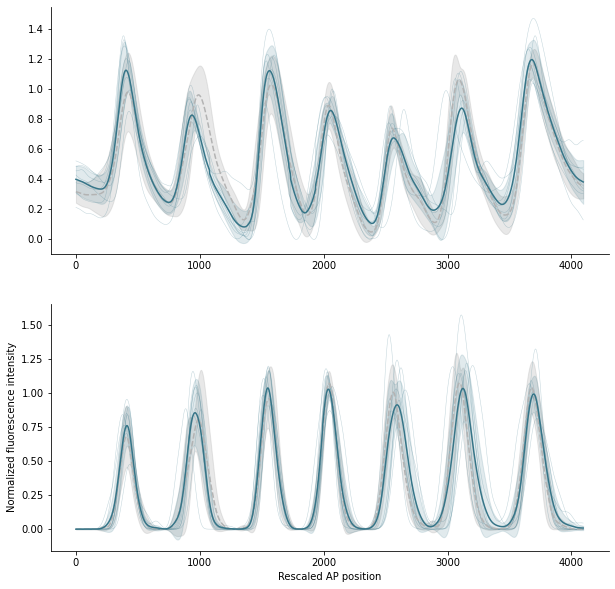

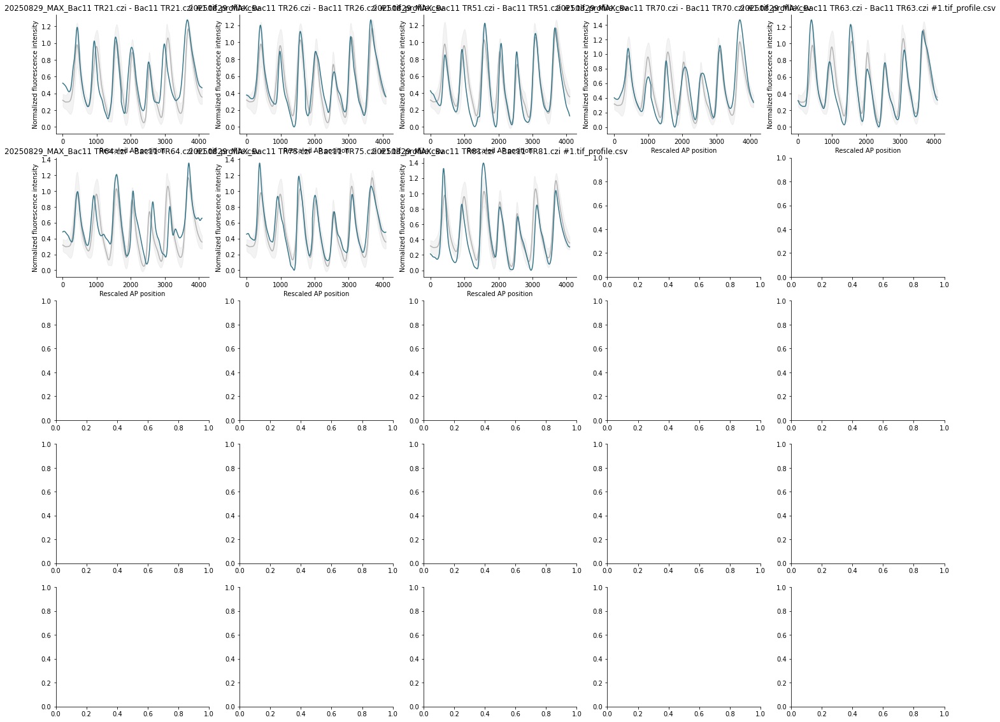

In [7]:
# AVERAGE PROFILES FOR ALL TIME POINTS CONTROL EMBRYOS AND COMPARE TO EXPERIMENT

Timepoints = ['20','30','40','50'];

Ctr = 'BACctr/'
Exps = ['BAC_5-3/','BAC_5-4/','BAC_5-5/','BAC_6-2/','BAC_7-0/','BAC_7-3/','BAC_7-4/','BAC_7-5/','BAC_8-0/','BAC_8-2/','BAC_8-3/','BAC_8-4/', 'BAC_9-0/','Bac_4/', 'Bac_5/','Bac_6/','Bac_7/','Bac_8/','Bac_11/']
Path = '/Volumes/ElementsOld/Confocal/to_analyze/'
DataFrame = pd.DataFrame()
DataFrame['Sample'] = np.nan
DataFrame['TimePoint'] = np.nan
DataFrame['n'] = np.nan
DataFrame['avPeakSt2'] = np.nan
DataFrame['SEPeakSt2'] = np.nan
DataFrame['avPeakSpotsSt2'] = np.nan
DataFrame['SEPeakSpotsSt2'] = np.nan
DataFrame['avSpotsSt23'] = np.nan
DataFrame['SESpotsSt23'] = np.nan
DataFrame['avWidthSt2'] = np.nan
DataFrame['SEWidthSt2'] = np.nan
DataFrame['avFractionSpots23'] = np.nan
DataFrame['SEFractionSpots23'] = np.nan
DataFrame['FCPeakSpotsSt2'] = np.nan
DataFrame['FCSpotsSt23'] = np.nan
DataFrame['FCWidthSt2'] = np.nan
DataFrame['FCFractionSpots23'] = np.nan

for Timepoint in Timepoints:
    FullPath = Path+Ctr+Timepoint+'/'
    Split = FullPath.split('/')
    FilesDF = [f for f in os.listdir(FullPath) if re.match(r"\w.*profile\.csv$", f)]
    print(FilesDF)
    InterpolatedProfilesCtr = np.zeros((4096,len(FilesDF)))
    InterpolatedSpotsProfilesCtr = np.zeros((4096,len(FilesDF)))
    i=0
    XYRes = 0.01
    fig, ax = plt.subplots(2, 1, figsize=(10, 10))
    
    NewLine = len(DataFrame)
    DataFrame.loc[NewLine,'Sample'] = Ctr
    DataFrame.loc[NewLine,'TimePoint'] = Timepoint

    Intensity2 = [None]*len(FilesDF)
    IntensitySpots2 = [None]*len(FilesDF)
    Spots23 = [None]*len(FilesDF)
    Width2 = [None]*len(FilesDF)
    Fraction23 = [None]*len(FilesDF)
    
    for file in FilesDF:
        Profile = np.loadtxt(FullPath+file, delimiter = ',')
        StripesFile = file.replace("profile.csv", "stripes.csv")
        SpotsProfileFile = file.replace("profile.csv", "profile_spots.csv")
        SpotsFile = file.replace("profile.csv", "spots.csv")

        StripePos = np.loadtxt(FullPath+StripesFile, delimiter = ',')
        SpotsProfile = np.loadtxt(FullPath+SpotsProfileFile, delimiter = ',')
        SpotsProfile = gaussian_filter1d(SpotsProfile, sigma=20)
        [stripesDictSpots,stripesListSpots] = StripesFunctions.detect_stripes(range(0,len(SpotsProfile)), SpotsProfile)
        
        Stripe1 = np.round(np.min(StripePos)/100*len(Profile))
        Stripe2 = np.round(StripePos[1]/100*len(Profile))
        Stripe3 = np.round(StripePos[2]/100*len(Profile))
        Stripe4 = np.round(StripePos[3]/100*len(Profile))
        Stripe5 = np.round(StripePos[4]/100*len(Profile))
        Stripe6 = np.round(StripePos[5]/100*len(Profile))
        Stripe7 = np.round(np.max(StripePos)/100*len(Profile))
        RescaledX = ((range(0,len(Profile)) - Stripe1) / (Stripe7 - Stripe1))*len(Profile)*0.8+0.1*len(Profile)
        RescaledX1 = ((range(0,int(len(Profile)/2)) - Stripe1) / (Stripe4 - Stripe1))*0.5
        RescaledX2 = ((range(int(len(Profile)/2),len(Profile))-Stripe4) / (Stripe7 - Stripe4))*0.5+0.5
        RescaledX = np.concatenate([RescaledX1, RescaledX2], axis = 0)*len(Profile)*0.8+0.1*len(Profile)
#         RescaledX1 = ((range(0,int(len(Profile)/6)) - Stripe1) / (Stripe2 - Stripe1))/6
#         RescaledX2 = ((range(0,int(len(Profile)/6)+1) + int(len(Profile)/6) - Stripe2) / (Stripe3 - Stripe2))/6+0.1667*1
#         RescaledX3 = ((range(0,int(len(Profile)/6)) - Stripe3) / (Stripe4 - Stripe3))/6+0.1667*2
#         RescaledX4 = ((range(0,int(len(Profile)/6)+1) - Stripe4) / (Stripe5 - Stripe4))/6+0.1667*3
#         RescaledX5 = ((range(0,int(len(Profile)/6)+1) - Stripe5) / (Stripe6 - Stripe5))/6+0.1667*4
#         RescaledX6 = ((range(0,int(len(Profile)/6)+1) - Stripe6) / (Stripe7 - Stripe6))/6+0.1667*5
#         RescaledX = np.concatenate([RescaledX1, RescaledX2, RescaledX3, RescaledX4, RescaledX5, RescaledX6], axis = 0)*len(Profile)*0.8+0.1*len(Profile)
        
#         RescaledX = np.concatenate([(range(0,int(len(Profile)/2)) - Stripe1), (range(int(len(Profile)/2+1),len(Profile)+1) - Stripe4)], axis = 0) / (Stripe7 - Stripe1)*0.8+0.1*len(Profile)
#         ProfileNorm = (Profile-np.nanmin(Profile))/(Profile[int(Stripe3)]-np.nanmin(Profile))
        # normalize to the average of all stripes except 2
        ProfileNorm = (Profile-np.nanmin(Profile))/(np.nanmean([Profile[int(Stripe1)],Profile[int(Stripe3)],Profile[int(Stripe4)],Profile[int(Stripe5)],Profile[int(Stripe6)],Profile[int(Stripe7)]])-np.nanmin(Profile))

    
        Stripe1Spots = np.round(np.min(stripesListSpots)/100*len(Profile))
        Stripe2Spots = np.round(stripesListSpots[1]/100*len(Profile))
        Stripe3Spots = np.round(stripesListSpots[2]/100*len(Profile))
        Stripe4Spots = np.round(stripesListSpots[3]/100*len(Profile))
        Stripe5Spots = np.round(stripesListSpots[4]/100*len(Profile))
        Stripe6Spots = np.round(stripesListSpots[5]/100*len(Profile))
        Stripe7Spots = np.round(np.max(stripesListSpots)/100*len(Profile))
        RescaledX1 = ((range(0,int(len(Profile)/2)) - Stripe1Spots) / (Stripe4Spots - Stripe1Spots))*0.5
        RescaledX2 = ((range(int(len(Profile)/2),len(Profile))-Stripe4Spots) / (Stripe7Spots - Stripe4Spots))*0.5+0.5
        RescaledXSpots = np.concatenate([RescaledX1, RescaledX2], axis = 0)*len(Profile)*0.8+0.1*len(Profile)

#         SpotsProfileNorm = (SpotsProfile-np.nanmin(SpotsProfile))/(SpotsProfile[int(Stripe3Spots)]-np.nanmin(SpotsProfile))
        SpotsProfileNorm = (SpotsProfile-np.nanmin(SpotsProfile))/(np.nanmean([SpotsProfile[int(Stripe1Spots)],SpotsProfile[int(Stripe3Spots)],SpotsProfile[int(Stripe4Spots)],SpotsProfile[int(Stripe5Spots)],SpotsProfile[int(Stripe6Spots)],SpotsProfile[int(Stripe7Spots)]])-np.nanmin(SpotsProfile))

#         print(Profile)
#         plt.plot(range(0,len(ProfileNorm))-Stripe1,Profile)
#         plt.plot(RescaledX,ProfileNorm)
        InterpolatedProfile = np.interp(range(0,len(RescaledX)),RescaledX, ProfileNorm, right=None)
        InterpolatedSpotsProfile = np.interp(range(0,len(RescaledXSpots)),RescaledXSpots, SpotsProfileNorm, right=None)
        ax[0].plot(InterpolatedProfile,'-',color=(0.7, 0.7, 0.7),linewidth=0.5)
        ax[1].plot(InterpolatedSpotsProfile,'-',color=(0.7, 0.7, 0.7),linewidth=0.5)
        InterpolatedProfilesCtr[0:len(InterpolatedProfile),i]=InterpolatedProfile
        InterpolatedSpotsProfilesCtr[0:len(InterpolatedSpotsProfile),i]=InterpolatedSpotsProfile
        # save average control and interpolated profile for each 
            
        Intensity2[i] = ProfileNorm[int(Stripe2)]
        IntensitySpots2[i] = SpotsProfileNorm[int(Stripe2Spots)]
        Spots = pd.read_csv(FullPath+SpotsFile)
        SubSpots2 = Spots[Spots.Labels==2]
        SubSpots3 = Spots[Spots.Labels==3]             
        Spots23[i] = np.nanmean(SubSpots2.SpotIntensity) / np.nanmean(SubSpots3.SpotIntensity)
        Width2[i] = 2*np.std(SubSpots2.adjCentroidX)
        Fraction23[i] = len(SubSpots2) / len(SubSpots3)
        i+=1

    DataFrame.loc[NewLine,'n'] = len(FilesDF)
    DataFrame.loc[NewLine,'avPeakSt2'] = np.nanmean(Intensity2)
    DataFrame.loc[NewLine,'SEPeakSt2'] = np.nanstd(Intensity2)/np.sqrt(len(FilesDF))
    DataFrame.loc[NewLine,'avPeakSpotsSt2'] = np.nanmean(IntensitySpots2)
    DataFrame.loc[NewLine,'SEPeakSpotsSt2'] = np.nanstd(IntensitySpots2)/np.sqrt(len(FilesDF))
    DataFrame.loc[NewLine,'avSpotsSt23'] = np.nanmean(Spots23)
    DataFrame.loc[NewLine,'SESpotsSt23'] = np.nanstd(Spots23)/np.sqrt(len(FilesDF))
    DataFrame.loc[NewLine,'avWidthSt2'] = np.nanmean(Width2)
    DataFrame.loc[NewLine,'SEWidthSt2'] = np.nanstd(Width2)/np.sqrt(len(FilesDF))
    DataFrame.loc[NewLine,'avFractionSpots23'] = np.nanmean(Fraction23)
    DataFrame.loc[NewLine,'SEFractionSpots23'] = np.nanstd(Fraction23)/np.sqrt(len(FilesDF))
    
    PeakSpotsSt2Ctr = np.nanmean(IntensitySpots2)
    SpotsSt23Ctr = np.nanmean(Spots23)
    Width2Ctr = np.nanmean(Width2)
    Fraction23Ctr = np.nanmean(Fraction23)
    DataFrame.loc[NewLine,'FCPeakSpotsSt2'] = 1
    DataFrame.loc[NewLine,'FCSpotsSt23'] = 1
    DataFrame.loc[NewLine,'FCWidthSt2'] = 1
    DataFrame.loc[NewLine,'FCFractionSpots23'] = 1
    
        
    MeanCtr = np.nanmean(InterpolatedProfilesCtr,axis=1)
    SDCtr = np.std(InterpolatedProfilesCtr,axis=1)
    plt.rcParams['axes.spines.right'] = False
    plt.rcParams['axes.spines.top'] = False
    ax[0].plot(MeanCtr,'-r')  
    ax[0].fill_between(range(0,len(ProfileNorm)),MeanCtr-SDCtr, MeanCtr+SDCtr, color='red', alpha=0.15, label='Standard Deviation')
    plt.xlabel('Rescaled AP position')
    plt.ylabel('Normalized fluorescence intensity')

    MeanSpotsCtr = np.nanmean(InterpolatedSpotsProfilesCtr,axis=1)
    SDSpotsCtr = np.std(InterpolatedSpotsProfilesCtr,axis=1)
    plt.rcParams['axes.spines.right'] = False
    plt.rcParams['axes.spines.top'] = False
    ax[1].plot(MeanSpotsCtr,'-r')  
    ax[1].fill_between(range(0,len(ProfileNorm)),MeanSpotsCtr-SDSpotsCtr, MeanSpotsCtr+SDSpotsCtr, color='red', alpha=0.15, label='Standard Deviation')
    plt.xlabel('Rescaled AP position')
    plt.ylabel('Normalized fluorescence intensity')
    
    plt.savefig(Path+Ctr+'/'+"_"+Split[-3]+"_"+Split[-2]+"_average_profiles.pdf")    



    # INDIVIDUAL MUTANT PROFILES COMPARED CONTROL EMBRYOS
    for Exp in Exps:
        FullPath = Path+Exp+Timepoint+'/'
        Split = FullPath.split('/')
        FilesDF = [f for f in os.listdir(FullPath) if re.match(r"\w.*profile\.csv$", f)]
        print(FilesDF)
        InterpolatedProfiles = np.zeros((4096,len(FilesDF)))
        InterpolatedSpotsProfiles = np.zeros((4096,len(FilesDF)))
        i=0
        XYRes = 0.01
        fig, ax = plt.subplots(2, 1, figsize=(10, 10))

        NewLine = len(DataFrame)
        DataFrame.loc[NewLine,'Sample'] = Exp
        DataFrame.loc[NewLine,'TimePoint'] = Timepoint

        Intensity2 = [None]*len(FilesDF)
        IntensitySpots2 = [None]*len(FilesDF)
        Spots23 = [None]*len(FilesDF)
        Width2 = [None]*len(FilesDF)
        Fraction23 = [None]*len(FilesDF)

        for file in FilesDF:
            Profile = np.loadtxt(FullPath+file, delimiter = ',')
            StripesFile = file.replace("profile.csv", "stripes.csv")
            SpotsProfileFile = file.replace("profile.csv", "profile_spots.csv")
            SpotsFile = file.replace("profile.csv", "spots.csv")
            StripePos = np.loadtxt(FullPath+StripesFile, delimiter = ',')
            SpotsProfile = np.loadtxt(FullPath+SpotsProfileFile, delimiter = ',')
            SpotsProfile = gaussian_filter1d(SpotsProfile, sigma=20)
            [stripesDictSpots,stripesListSpots] = StripesFunctions.detect_stripes(range(0,len(SpotsProfile)), SpotsProfile)

            Stripe1 = np.round(np.min(StripePos)/100*len(Profile))
            Stripe2 = np.round(StripePos[1]/100*len(Profile))
            Stripe3 = np.round(StripePos[2]/100*len(Profile))
            Stripe4 = np.round(StripePos[3]/100*len(Profile))
            Stripe5 = np.round(StripePos[4]/100*len(Profile))
            Stripe6 = np.round(StripePos[5]/100*len(Profile))
            Stripe7 = np.round(np.max(StripePos)/100*len(Profile))
            Stripe1Spots = np.round(np.min(stripesListSpots)/100*len(Profile))
            Stripe2Spots = np.round(stripesListSpots[1]/100*len(Profile))
            Stripe3Spots = np.round(stripesListSpots[2]/100*len(Profile))
            Stripe4Spots = np.round(stripesListSpots[3]/100*len(Profile))
            Stripe5Spots = np.round(stripesListSpots[4]/100*len(Profile))
            Stripe6Spots = np.round(stripesListSpots[5]/100*len(Profile))
            Stripe7Spots = np.round(np.max(stripesListSpots)/100*len(Profile))

    #         Stripe1 = np.round(np.min(StripePos)/100*4096)
    #         Stripe7 = np.round(np.max(StripePos)/100*4096)
# #         RescaledX = ((range(0,len(Profile)) - Stripe1) / (Stripe7 - Stripe1))*len(Profile)*0.8+0.1*len(Profile)
            RescaledX1 = ((range(0,int(len(Profile)/2)) - Stripe1) / (Stripe4 - Stripe1))*0.5
            RescaledX2 = ((range(int(len(Profile)/2),len(Profile))-Stripe4) / (Stripe7 - Stripe4))*0.5+0.5
            RescaledX = np.concatenate([RescaledX1, RescaledX2], axis = 0)*len(Profile)*0.8+0.1*len(Profile)
    #         RescaledX = ((range(0,len(Profile)) - Stripe1) / (Stripe7 - Stripe1))*4096*0.8+0.1*4096
            ProfileNorm = (Profile-np.nanmin(Profile))/(np.nanmean([Profile[int(Stripe1)],Profile[int(Stripe3)],Profile[int(Stripe4)],Profile[int(Stripe5)],Profile[int(Stripe6)],Profile[int(Stripe7)]])-np.nanmin(Profile))

            RescaledX1 = ((range(0,int(len(Profile)/2)) - Stripe1Spots) / (Stripe4Spots - Stripe1Spots))*0.5
            RescaledX2 = ((range(int(len(Profile)/2),len(Profile))-Stripe4Spots) / (Stripe7Spots - Stripe4Spots))*0.5+0.5
            RescaledXSpots = np.concatenate([RescaledX1, RescaledX2], axis = 0)*len(Profile)*0.8+0.1*len(Profile)
    #         RescaledXSpots = ((range(0,len(Profile)) - Stripe1Spots) / (Stripe7Spots - Stripe1Spots))*4096*0.8+0.1*4096     
            SpotsProfileNorm = (SpotsProfile-np.nanmin(SpotsProfile))/(np.nanmean([SpotsProfile[int(Stripe1Spots)],SpotsProfile[int(Stripe3Spots)],SpotsProfile[int(Stripe4Spots)],SpotsProfile[int(Stripe5Spots)],SpotsProfile[int(Stripe6Spots)],SpotsProfile[int(Stripe7Spots)]])-np.nanmin(SpotsProfile))

            if len(ProfileNorm)<4096:
                ProfileNorm = np.hstack((ProfileNorm,np.ones((4096-len(ProfileNorm)))*4096))  
                RescaledX = np.hstack((RescaledX,np.ones((4096-len(RescaledX)))*4096)) 
                SpotsProfileNorm = np.hstack((SpotsProfileNorm,np.ones((4096-len(SpotsProfileNorm)))*4096))  
                RescaledXSpots = np.hstack((RescaledXSpots,np.ones((4096-len(RescaledXSpots)))*4096))

            InterpolatedProfile = np.interp(range(0,len(RescaledX)),RescaledX, ProfileNorm, right=None)
            InterpolatedSpotsProfile = np.interp(range(0,len(RescaledXSpots)),RescaledXSpots, SpotsProfileNorm, right=None)
            ax[0].plot(InterpolatedProfile,'-',color='#367588',linewidth=0.5, alpha=0.3)
            ax[1].plot(InterpolatedSpotsProfile,'-',color='#367588',linewidth=0.5, alpha=0.3)
            InterpolatedProfiles[0:len(InterpolatedProfile),i]=InterpolatedProfile
            InterpolatedSpotsProfiles[0:len(InterpolatedSpotsProfile),i]=InterpolatedSpotsProfile
            # save average control and interpolated profile for each
            np.savetxt(FullPath+file+'_interpolated_profiles.csv',np.vstack((MeanCtr,InterpolatedProfile,MeanSpotsCtr,InterpolatedSpotsProfile)), fmt='%s',delimiter = ',', header = Exp+Timepoint)
    #         print(i)
            Intensity2[i] = ProfileNorm[int(Stripe2)]
            IntensitySpots2[i] = SpotsProfileNorm[int(Stripe2Spots)]
            Spots = pd.read_csv(FullPath+SpotsFile)
            SubSpots2 = Spots[Spots.Labels==2]
            SubSpots3 = Spots[Spots.Labels==3]             
            Spots23[i] = np.nanmean(SubSpots2.SpotIntensity) / np.nanmean(SubSpots3.SpotIntensity)
            Width2[i] = 2*np.std(SubSpots2.adjCentroidX)
            Fraction23[i] = len(SubSpots2) / len(SubSpots3)
            i+=1

        DataFrame.loc[NewLine,'n'] = len(FilesDF)
        DataFrame.loc[NewLine,'avPeakSt2'] = np.nanmean(Intensity2)
        DataFrame.loc[NewLine,'SEPeakSt2'] = np.nanstd(Intensity2)/np.sqrt(len(FilesDF))
        DataFrame.loc[NewLine,'avPeakSpotsSt2'] = np.nanmean(IntensitySpots2)
        DataFrame.loc[NewLine,'SEPeakSpotsSt2'] = np.nanstd(IntensitySpots2)/np.sqrt(len(FilesDF))
        DataFrame.loc[NewLine,'FCPeakSpotsSt2'] = np.nanmean(IntensitySpots2)/PeakSpotsSt2Ctr
        DataFrame.loc[NewLine,'avSpotsSt23'] = np.nanmean(Spots23)
        DataFrame.loc[NewLine,'SESpotsSt23'] = np.nanstd(Spots23)/np.sqrt(len(FilesDF))
        DataFrame.loc[NewLine,'FCSpotsSt23'] = np.nanmean(Spots23)/SpotsSt23Ctr
        DataFrame.loc[NewLine,'avWidthSt2'] = np.nanmean(Width2)
        DataFrame.loc[NewLine,'SEWidthSt2'] = np.nanstd(Width2)/np.sqrt(len(FilesDF))
        DataFrame.loc[NewLine,'FCWidthSt2'] = np.nanmean(Width2)/Width2Ctr
        DataFrame.loc[NewLine,'avFractionSpots23'] = np.nanmean(Fraction23)
        DataFrame.loc[NewLine,'SEFractionSpots23'] = np.nanstd(Fraction23)/np.sqrt(len(FilesDF))
        DataFrame.loc[NewLine,'FCFractionSpots23'] = np.nanmean(Fraction23)/Fraction23Ctr

        Mean = np.nanmean(InterpolatedProfiles,axis=1)
        SD = np.std(InterpolatedProfiles,axis=1)
        plt.rcParams['axes.spines.right'] = False
        plt.rcParams['axes.spines.top'] = False
        ax[0].plot(MeanCtr,'--',color=(0.7, 0.7, 0.7)) 
        ax[0].fill_between(range(0,len(ProfileNorm)),MeanCtr-SDCtr, MeanCtr+SDCtr, color=(0.7, 0.7, 0.7), alpha=0.3, label='Standard Deviation')
        ax[0].plot(Mean,'-', color = '#367588')  
        ax[0].fill_between(range(0,len(ProfileNorm)),Mean-SD, Mean+SD, color='#367588', alpha=0.15, label='Standard Deviation')
        plt.xlabel('Rescaled AP position')
        plt.ylabel('Normalized fluorescence intensity')

        MeanSpots = np.nanmean(InterpolatedSpotsProfiles,axis=1)
        SDSpots = np.std(InterpolatedSpotsProfiles,axis=1)
        plt.rcParams['axes.spines.right'] = False
        plt.rcParams['axes.spines.top'] = False
        ax[1].plot(MeanSpotsCtr,'--',color=(0.7, 0.7, 0.7)) 
        ax[1].fill_between(range(0,len(ProfileNorm)),MeanSpotsCtr-SDSpotsCtr, MeanSpotsCtr+SDSpotsCtr, color=(0.7, 0.7, 0.7), alpha=0.3, label='Standard Deviation')
        ax[1].plot(MeanSpots,'-', color = '#367588')  
        ax[1].fill_between(range(0,len(ProfileNorm)),MeanSpots-SDSpots, MeanSpots+SDSpots, color='#367588', alpha=0.15, label='Standard Deviation')
        plt.xlabel('Rescaled AP position')
        plt.ylabel('Normalized fluorescence intensity')

        plt.savefig(Path+Exp+'/'+"_"+Split[-3]+"_"+Split[-2]+"_average_profiles.pdf")  

        fig, ax = plt.subplots(5, 5, figsize=(25, 20))
        for j in range(0,len(FilesDF)):
            row = math.floor(j/5)
            col = j - row*5
            ax[row,col].plot(MeanCtr,'-',color=(0.7, 0.7, 0.7))  
            ax[row,col].fill_between(range(0,len(ProfileNorm)),MeanCtr-SDCtr, MeanCtr+SDCtr, color=(0.7, 0.7, 0.7), alpha=0.15, label='Standard Deviation')
            ax[row,col].plot(InterpolatedProfiles[:,j],'-',color='#367588')  
            ax[row,col].set_xlabel('Rescaled AP position')
            ax[row,col].set_ylabel('Normalized fluorescence intensity')
            ax[row,col].set_title(FilesDF[j])
        fig.savefig(Path+Exp+'/'+"_"+Split[-3]+"_"+Split[-2]+"_all_plots_comp.pdf")  

        fig, ax = plt.subplots(5, 5, figsize=(25, 20))
        for j in range(0,len(FilesDF)):
            row = math.floor(j/5)
            col = j - row*5
            ax[row,col].plot(MeanSpotsCtr,'-',color=(0.7, 0.7, 0.7))  
            ax[row,col].fill_between(range(0,len(ProfileNorm)),MeanSpotsCtr-SDSpotsCtr, MeanSpotsCtr+SDSpotsCtr, color=(0.7, 0.7, 0.7), alpha=0.15, label='Standard Deviation')
            ax[row,col].plot(InterpolatedSpotsProfiles[:,j],'-',color='#367588')  
            ax[row,col].set_xlabel('Rescaled AP position')
            ax[row,col].set_ylabel('Normalized fluorescence intensity')
            ax[row,col].set_title(FilesDF[j])
        fig.savefig(Path+Exp+'/'+"_"+Split[-3]+"_"+Split[-2]+"_all_plots_comp_spots.pdf") 
        plt.close()



In [8]:
DataFrame.reindex()
print(DataFrame)
SubDF = DataFrame.loc[DataFrame.TimePoint == '30',:]
# Exps = ['BAC_5-3/','BAC_5-4/','BAC_5-5/','BAC_6-2/','BAC_7-0/','BAC_7-3/','BAC_7-4/','BAC_7-5/','BAC_8-0/','BAC_8-2/','BAC_8-3/','BAC_8-4/', 'BAC_9-0/','Bac_4/', 'Bac_5/','Bac_6/','Bac_7/','Bac_8/','Bac_11/']

SubDF['Colors'] = ['darkgray','lightcoral','indianred','indianred','lightcoral','indianred','lightcoral','indianred','lightcoral','lightcoral','lightcoral','lightcoral','indianred','lightcoral','indianred','lightcoral','indianred','lightcoral','indianred','lightcoral']
SubDF = SubDF.sort_values(by = "avPeakSpotsSt2")
SampleOrder = SubDF.Sample
Ns = DataFrame.pivot(index='TimePoint', columns='Sample', values='n').reindex(columns=SampleOrder)

# DataFrame.TimePoint
Colors = SubDF.Colors

      Sample TimePoint    n  avPeakSt2  SEPeakSt2  avPeakSpotsSt2  \
0    BACctr/        20  5.0   1.108945   0.069559        1.222131   
1   BAC_5-3/        20  1.0   0.795906   0.000000        0.877326   
2   BAC_5-4/        20  5.0   0.657466   0.049340        0.532375   
3   BAC_5-5/        20  5.0   1.134395   0.380674        0.361056   
4   BAC_6-2/        20  4.0   1.057385   0.151613        0.928382   
..       ...       ...  ...        ...        ...             ...   
75    Bac_5/        50  8.0   1.028840   0.072196        0.989693   
76    Bac_6/        50  8.0   0.863036   0.075989        0.896467   
77    Bac_7/        50  3.0   0.839784   0.052308        0.948451   
78    Bac_8/        50  4.0   0.703653   0.058185        1.069020   
79   Bac_11/        50  8.0   0.864424   0.035780        0.945131   

    SEPeakSpotsSt2  avSpotsSt23  SESpotsSt23  avWidthSt2  SEWidthSt2  \
0         0.028794     0.962046     0.023697  165.265658    8.657117   
1         0.000000     1.00

/var/folders/06/3s9rymq14dl6ps79xbr4t6bw0000gp/T/ipykernel_80282/4061177695.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  SubDF['Colors'] = ['darkgray','lightcoral','indianred','indianred','lightcoral','indianred','lightcoral','indianred','lightcoral','lightcoral','lightcoral','lightcoral','indianred','lightcoral','indianred','lightcoral','indianred','lightcoral','indianred','lightcoral']


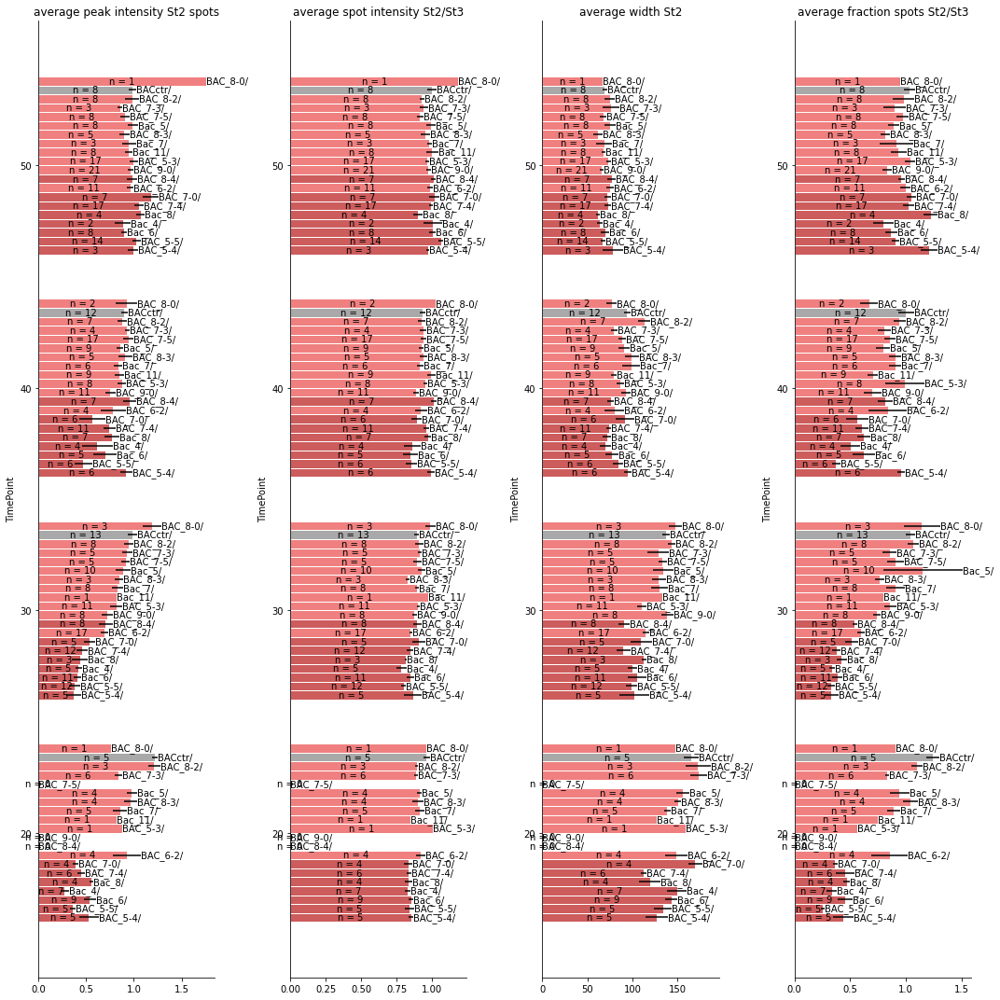

In [9]:
fig, ax = plt.subplots(1,4, figsize=(15, 15))

# DataFrame["TimePoint"] = DataFrame["TimePoint"].astype('category')
# pivot_df = DataFrame.pivot(index='TimePoint', columns='Sample', values='avPeakSt2')
# pivot_err = DataFrame.pivot(index='TimePoint', columns='Sample', values='SEPeakSt2')
# pivot_df.plot(ax = ax[0], kind = 'bar', width = 0.8, edgecolor='white', yerr = pivot_err, color = Colors, title = 'average peak intensity St2 all signal').legend(loc='right',bbox_to_anchor=(1.1, 0.5))

pivot_df = DataFrame.pivot(index='TimePoint', columns='Sample', values='avPeakSpotsSt2').reindex(columns=SampleOrder)
pivot_err = DataFrame.pivot(index='TimePoint', columns='Sample', values='SEPeakSpotsSt2').reindex(columns=SampleOrder)
bars = pivot_df.plot(ax = ax[0], kind = 'barh', width = 0.8, edgecolor='white', xerr = pivot_err, color = Colors,title = 'average peak intensity St2 spots', legend = False)
# bars.legend(loc='right',bbox_to_anchor=(1.1, 0.5))
i=0
for container in bars.containers[1::2]:
        Labels = Ns.iloc[:,i]
        Labels = [f'n = {int(x)}' for x in Ns.iloc[:,i]]
        bars.bar_label(container, labels=Labels, fmt='n = {:d}', label_type = 'center')
        bars.bar_label(container, labels=[SampleOrder.values[i]]*4, label_type = 'edge')
        i+=1

pivot_df = DataFrame.pivot(index='TimePoint', columns='Sample', values='avSpotsSt23').reindex(columns=SampleOrder)
pivot_err = DataFrame.pivot(index='TimePoint', columns='Sample', values='SESpotsSt23').reindex(columns=SampleOrder)
bars = pivot_df.plot(ax = ax[1], kind = 'barh', width = 0.8, edgecolor='white', xerr = pivot_err,color = Colors, title = 'average spot intensity St2/St3', legend = False)
# bars.legend(loc='right',bbox_to_anchor=(1.1, 0.5))
i=0
for container in bars.containers[1::2]:
        Labels = Ns.iloc[:,i]
        Labels = [f'n = {int(x)}' for x in Ns.iloc[:,i]]
        bars.bar_label(container, labels=Labels, fmt='n = {:d}', label_type = 'center')
        bars.bar_label(container, labels=[SampleOrder.values[i]]*4, label_type = 'edge')
        i+=1

pivot_df = DataFrame.pivot(index='TimePoint', columns='Sample', values='avWidthSt2').reindex(columns=SampleOrder)
pivot_err = DataFrame.pivot(index='TimePoint', columns='Sample', values='SEWidthSt2').reindex(columns=SampleOrder)
bars = pivot_df.plot(ax = ax[2], kind = 'barh', width = 0.8, edgecolor='white', xerr = pivot_err, color = Colors,title = 'average width St2', legend = False)
# bars.legend(loc='right',bbox_to_anchor=(1.1, 0.5))
i=0
for container in bars.containers[1::2]:
        Labels = Ns.iloc[:,i]
        Labels = [f'n = {int(x)}' for x in Ns.iloc[:,i]]
        bars.bar_label(container, labels=Labels, fmt='n = {:d}', label_type = 'center')
        bars.bar_label(container, labels=[SampleOrder.values[i]]*4, label_type = 'edge')
        i+=1

pivot_df = DataFrame.pivot(index='TimePoint', columns='Sample', values='avFractionSpots23').reindex(columns=SampleOrder)
pivot_err = DataFrame.pivot(index='TimePoint', columns='Sample', values='SEFractionSpots23').reindex(columns=SampleOrder)
bars = pivot_df.plot(ax = ax[3], kind = 'barh', width = 0.8, edgecolor='white', xerr = pivot_err,color = Colors, title = 'average fraction spots St2/St3', legend = False)
# bars.legend(loc='right',bbox_to_anchor=(1.1, 0.5))
i=0
for container in bars.containers[1::2]:
        Labels = Ns.iloc[:,i]
        Labels = [f'n = {int(x)}' for x in Ns.iloc[:,i]]
        bars.bar_label(container, labels=Labels, fmt='n = {:d}', label_type = 'center')
        bars.bar_label(container, labels=[SampleOrder.values[i]]*4, label_type = 'edge')
        i+=1

# for axis in ax:
#     axis.minorticks_on() # "Activate" minor ticks
#     rects_locs = map(lambda y: y.get_y() +y.get_height()/2., axis.patches) # Get location of the center of each rectangle
#     axis.set_yticks(rects_locs, minor = True) # Set minor ticks there
# #     new_ticks = reduce(lambda x, y: x + y, map(lambda x: [x] * pivot_df.shape[0], pivot_df.columns)) # Labels for the rectangles
# #     from matplotlib import ticker # Set the labels
# #     axis.xaxis.set_minor_formatter(ticker.FixedFormatter(new_ticks))  #add the custom ticks
# #     axis.tick_params(axis='x', which='major', pad=15) # Move the category label further from x-axis
# #     axis.tick_params(axis='x',which='both', top='off')# Remove minor ticks where not necessary
# #     axis.tick_params(axis='y',which='both', left='off', right = 'off')


fig.tight_layout()
fig.savefig(Path+"_"+Split[-3]+"_comp_variables.pdf") 
DataFrame.to_csv(Path+'all_variables.csv', index=False)


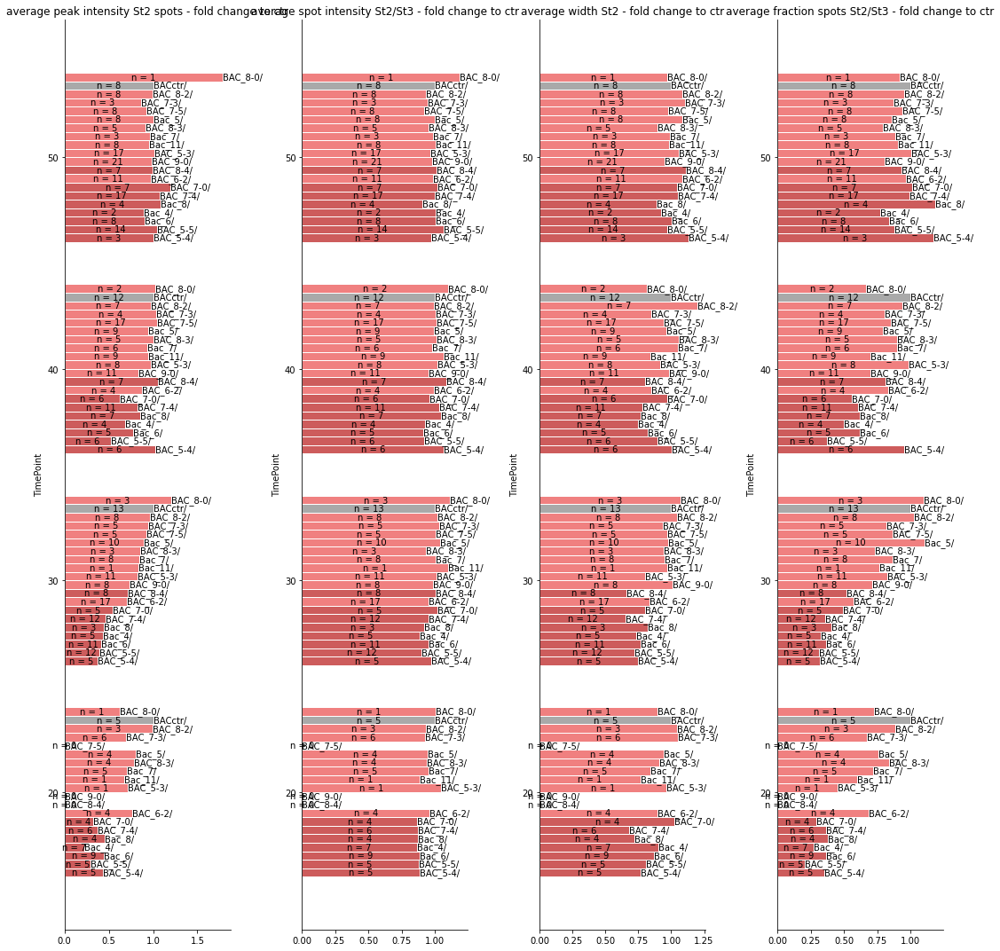

In [10]:
fig, ax = plt.subplots(1, 4, figsize=(15, 15))

# DataFrame["TimePoint"] = DataFrame["TimePoint"].astype('category')
# pivot_df = DataFrame.pivot(index='TimePoint', columns='Sample', values='avPeakSt2')
# pivot_err = DataFrame.pivot(index='TimePoint', columns='Sample', values='SEPeakSt2')
# pivot_df.plot(ax = ax[0], kind = 'bar', width = 0.8, edgecolor='white', yerr = pivot_err, color = Colors, title = 'average peak intensity St2 all signal').legend(loc='right',bbox_to_anchor=(1.1, 0.5))

pivot_df = DataFrame.pivot(index='TimePoint', columns='Sample', values='FCPeakSpotsSt2').reindex(columns=SampleOrder)
bars = pivot_df.plot(ax = ax[0], kind = 'barh', width = 0.8, edgecolor='white', color = Colors,title = 'average peak intensity St2 spots - fold change to ctr', legend = False)
# bars.legend(loc='right',bbox_to_anchor=(1.1, 0.5))
i=0
for container in bars.containers:
        Labels = Ns.iloc[:,i]
        Labels = [f'n = {int(x)}' for x in Ns.iloc[:,i]]
        bars.bar_label(container, labels=Labels, fmt='n = {:d}', label_type = 'center')
        bars.bar_label(container, labels=[SampleOrder.values[i]]*4, label_type = 'edge')
        i+=1
        
pivot_df = DataFrame.pivot(index='TimePoint', columns='Sample', values='FCSpotsSt23').reindex(columns=SampleOrder)
bars = pivot_df.plot(ax = ax[1], kind = 'barh', width = 0.8, edgecolor='white', color = Colors, title = 'average spot intensity St2/St3 - fold change to ctr', legend = False)
# bars.legend(loc='right',bbox_to_anchor=(1.1, 0.5))
i=0
for container in bars.containers:
        Labels = Ns.iloc[:,i]
        Labels = [f'n = {int(x)}' for x in Ns.iloc[:,i]]
        bars.bar_label(container, labels=Labels, fmt='n = {:d}', label_type = 'center')
        bars.bar_label(container, labels=[SampleOrder.values[i]]*4, label_type = 'edge')
        i+=1
        
pivot_df = DataFrame.pivot(index='TimePoint', columns='Sample', values='FCWidthSt2').reindex(columns=SampleOrder)
bars = pivot_df.plot(ax = ax[2], kind = 'barh', width = 0.8, edgecolor='white', color = Colors,title = 'average width St2 - fold change to ctr', legend = False)
# bars.legend(loc='right',bbox_to_anchor=(1.1, 0.5))
i=0
for container in bars.containers:
        Labels = Ns.iloc[:,i]
        Labels = [f'n = {int(x)}' for x in Ns.iloc[:,i]]
        bars.bar_label(container, labels=Labels, fmt='n = {:d}', label_type = 'center')
        bars.bar_label(container, labels=[SampleOrder.values[i]]*4, label_type = 'edge')
        i+=1
        
pivot_df = DataFrame.pivot(index='TimePoint', columns='Sample', values='FCFractionSpots23').reindex(columns=SampleOrder)
bars = pivot_df.plot(ax = ax[3], kind = 'barh', width = 0.8, edgecolor='white', color = Colors, title = 'average fraction spots St2/St3 - fold change to ctr', legend = False)
# bars.legend(loc='right',bbox_to_anchor=(1.1, 0.5))
i=0
for container in bars.containers:
        Labels = Ns.iloc[:,i]
        Labels = [f'n = {int(x)}' for x in Ns.iloc[:,i]]
        bars.bar_label(container, labels=Labels, fmt='n = {:d}', label_type = 'center')
        bars.bar_label(container, labels=[SampleOrder.values[i]]*4, label_type = 'edge')
        i+=1
        
fig.tight_layout()
fig.savefig(Path+"_"+Split[-3]+"_comp_variablesFC.pdf") 


In [ ]:
SampleOrder.values